# Prac 05

In this homework you are going to implement the **Floyd-Steinberg dithering** algorithm. Dithering, in general, means that we are adding noise to the signal (in our case digital image) in order to perceive it better. In other words, by adding the noise the objective quality will be worse but the subjective quality will be better (i.e. the image will "look" better).

The details of FS dithering can be found in this [wiki](https://en.wikipedia.org/wiki/Floyd%E2%80%93Steinberg_dithering) page. In order to implement the dithering, we will implement the following steps:
* Define colour pallette
* Quantize the image to obtain the baseline and compute the average quantization error
* Implement FS dithering and compute the average quantization error

You will also have to answer the question at the end of this notebook.

Note: In this homework, you will have the chance to earn some extra points. See the "Bonus" section at the end of the notebook. Good luck!

As always, you are encouraged to use your own images :-)

In [56]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots


In [2]:
import cv2
import math
import numpy as np
from matplotlib import pyplot as plt
plt.rcParams['figure.figsize'] = [14, 8]

Let's load the image.

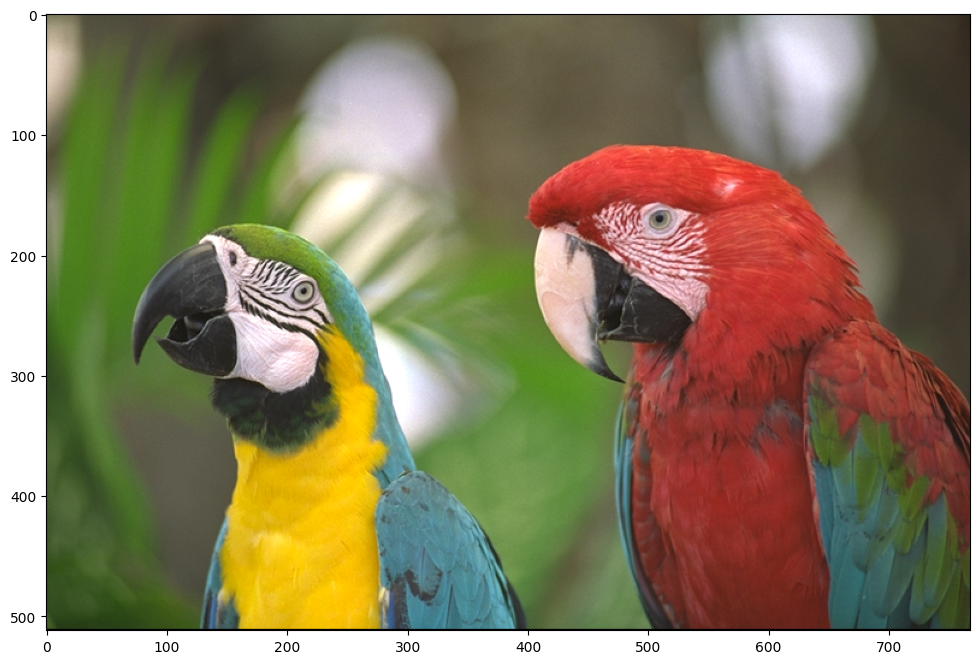

In [3]:
# Load image
img = cv2.imread('imgs/kodim23.png')
# Convert it to RGB
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
# Plot it
plt.imshow(img)

In [66]:
def plot_rgb_histograms(img):
    """
    Plots three separate interactive histograms for the Red, Green, and Blue channels 
    of a color image.
    """
    if img.ndim != 3 or img.shape[-1] != 3:
        print("Error: Image must be color (H, W, 3).")
        return

    # 1. Setup Plotly Subplots
    fig = make_subplots(
        rows=1, 
        cols=3, 
        subplot_titles=('Red (R)', 'Green (G)', 'Blue (B)')
    )
    
    colors = ('rgb(255, 0, 0)', 'rgb(0, 255, 0)', 'rgb(0, 0, 255)')
    channel_indices = [0, 1, 2] # R, G, B channels

    # 2. Iterate and Add Histogram Trace for Each Channel
    for i, (color_plotly, title) in enumerate(zip(colors, fig.layout.annotations)):
        
        channel_data = img[:, :, i].flatten()
        
        # Plotly requires data for its histogram trace
        fig.add_trace(
            go.Histogram(
                x=channel_data,
                name=title.text,
                xbins=dict(
                    start=0,
                    end=256,
                    size=1  # Corresponds to num_bins=256
                ),
                marker_color=color_plotly,
                opacity=0.8,
            ),
            row=1, 
            col=i + 1 # Column index (1, 2, 3)
        )
        
        # Update subplot axes properties
        fig.update_xaxes(
            title_text="Color Value (0 - 255)", 
            range=[-10, 265], 
            row=1, 
            col=i + 1
        )
        fig.update_yaxes(
            title_text="Pixel Count", 
            row=1, 
            col=i + 1
        )

    # 3. Final Figure Layout
    fig.update_layout(
        title_text="RGB Channel Histograms",
        showlegend=False,
        height=500,
        barmode='overlay' 
    )

    fig.show()


In [67]:
plot_rgb_histograms(img)

Let's start with gray tones first.

In [6]:
# Black, dark gray, light gray, white
colors = np.array([[0, 0, 0],
                   [64, 64, 64],
                   [192, 192, 192],
                   [255, 255, 255]])

Using the colour pallette, let's quantize the original image.

In [7]:
# Cast the image to float
img = img.astype(np.float32)

# Prepare for quantization
rows, cols, channels = img.shape
quantized = np.zeros_like(img)

# Apply quantization
for r in range(rows):
    for c in range(cols):
        # Extract the original pixel value
        pixel = img[r, c, :]
        
        # Find the closest colour from the pallette (using absolute value/Euclidean distance)
        # Note: You may need more than one line of code here
        closest_color = min(colors, key=lambda color: np.sum((color - pixel)**2))
        
        # # Apply quantization
        quantized[r, c, :] = closest_color

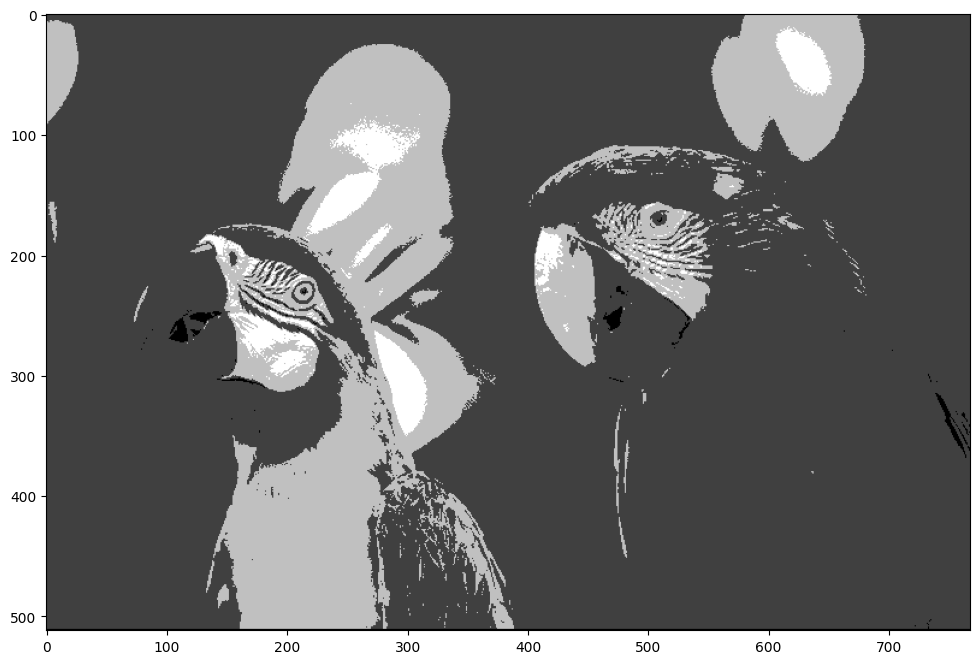

In [8]:
# Show quantized image (don't forget to cast back to uint8)
plt.imshow(quantized.astype(np.uint8))

In [9]:
# Compute average quantization error
avg_quant_error = np.abs(img - quantized).mean()
avg_quant_error

np.float32(32.75775)

#### Floyd-Steinberg Dithering
We are now going to implement the FS dithering and compare it to the optimally quantized image we have calculated above.

In [10]:
# Make a temporal copy of the original image, we will need it for error diffusion
img_tmp = np.copy(img)
dithering = np.zeros_like(img)


for r in range(1, rows-1):
    for c in range(1, cols-1):
        # Extract the original pixel value
        old_pixel = img_tmp[r, c, :]
        # Find the closest colour from the pallette (using absolute value/Euclidean distance)
        # Note: You may need more than one line of code here
        new_pixel = min(colors, key=lambda color: np.sum((color - old_pixel)**2))       
        
        dithering[r, c, :] = new_pixel
        # Compute quantization error
        quant_error = old_pixel - new_pixel
        
        # Diffuse the quantization error accroding to the FS diffusion matrix
        # Note: You may need more than one line of code here
        img_tmp[r, c+1, :] = img_tmp[r, c+1, :] + quant_error * (7 / 16)
        img_tmp[r+1, c-1, :] = img_tmp[r+1, c-1, :] + quant_error * (3 / 16)
        img_tmp[r+1, c, :] = img_tmp[r+1, c, :] + quant_error * (5 / 16)
        img_tmp[r+1, c+1, :] = img_tmp[r+1, c+1, :] + quant_error * (1 / 16)
        

In [ ]:
quantized = quantized.astype(np.uint8)
dithering = dithering.astype(np.uint8)

(<Axes: >, <matplotlib.image.AxesImage at 0x1411813ca50>)

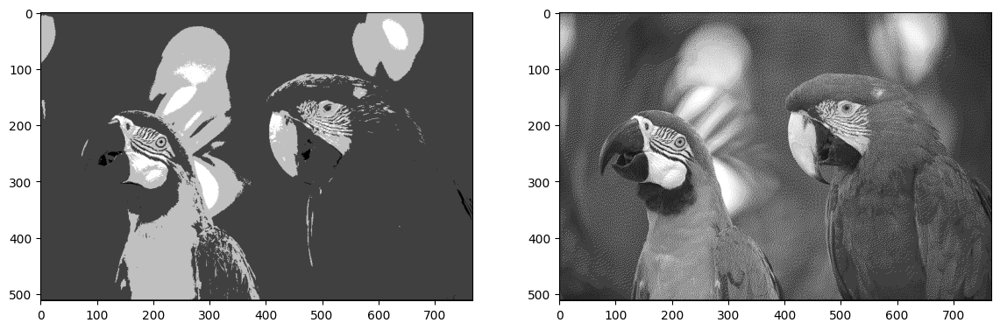

In [ ]:
# Show quantized image (don't forget to cast back to uint8)
plt.subplot(121), plt.imshow(quantized)   # optimally quantized
plt.subplot(122), plt.imshow(dithering)   # dithering

In [68]:
plot_rgb_histograms(quantized)

In [69]:
plot_rgb_histograms(dithering)

In [14]:
# Compute average quantization error for dithered image
avg_dith_error = np.abs(img - dithering).mean()
avg_dith_error

np.float32(41.83168)

In [43]:
def quantize(img, colors):
    if colors.shape[1] == 1:
        colors = np.hstack([colors, colors, colors])

    img_tmp = img.astype(np.float32).copy()
    diff = img_tmp[:, :, np.newaxis, :] - colors[np.newaxis, np.newaxis, :, :]
    distance_sq = np.sum(diff ** 2, axis=-1)
    min_index = np.argmin(distance_sq, axis=-1)
    quantized = colors[min_index]
    return quantized.astype(np.uint8)

In [16]:
def dithering_img(img, colors):
    img_tmp = np.copy(img)
    dithering = np.zeros_like(img)
    rows, cols, _ = img_tmp.shape

    for r in range(1, rows-1):
        for c in range(1, cols-1):

            old_pixel = img_tmp[r, c, :]

            new_pixel = min(colors, key=lambda color: np.sum((color - old_pixel)**2))       
            
            dithering[r, c, :] = new_pixel

            quant_error = old_pixel - new_pixel

            img_tmp[r, c+1, :] = img_tmp[r, c+1, :] + quant_error * (7 / 16)
            img_tmp[r+1, c-1, :] = img_tmp[r+1, c-1, :] + quant_error * (3 / 16)
            img_tmp[r+1, c, :] = img_tmp[r+1, c, :] + quant_error * (5 / 16)
            img_tmp[r+1, c+1, :] = img_tmp[r+1, c+1, :] + quant_error * (1 / 16)
            
    return dithering.astype(np.uint8)

In [17]:
colors_binary = np.array([[0, 0, 0], [255, 255, 255]])
quantized_binary = quantize(img, colors_binary)
dithering_binary = dithering_img(img, colors_binary)


(<Axes: >, <matplotlib.image.AxesImage at 0x1411f5ebb10>)

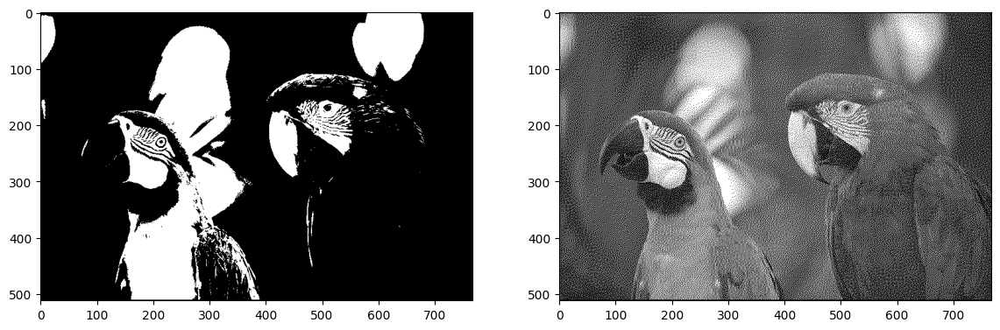

In [18]:
plt.subplot(121), plt.imshow(quantized_binary.astype(np.uint8))   # optimally quantized
plt.subplot(122), plt.imshow(dithering_binary.astype(np.uint8))   # dithering

In [70]:
plot_rgb_histograms(quantized_binary)
plot_rgb_histograms(dithering_binary)

### Questions
* Which image has higher quantization error? Optimally quantized or dithered?
* Which image looks better to you?
* Can you repeat the same process using only two colours: black and white? Show me :-)

1. dithered
2. dithered (especially binary color pallete)
3. done 

### Bonus Points

Repeat the homework using a diffrerent image pallette. For instance, you can use an optimal colour
pallette that we can calculate via k-means algorithm. The following snippet of code will give you the 16
optimal colours for your original image.

In [20]:
from sklearn.cluster import KMeans


In [39]:
kmeans_16_grey= KMeans(n_clusters=16).fit(np.reshape(img, (-1, 1)))
colors_kmeans_16_grey = kmeans_16_grey.cluster_centers_

In [44]:
quantized_16_grey = quantize(img, colors_kmeans_16_grey)


In [ ]:
dithering_16_grey = dithering_img(img, colors_kmeans_16_grey)

(<Axes: >, <matplotlib.image.AxesImage at 0x1413ae35bd0>)

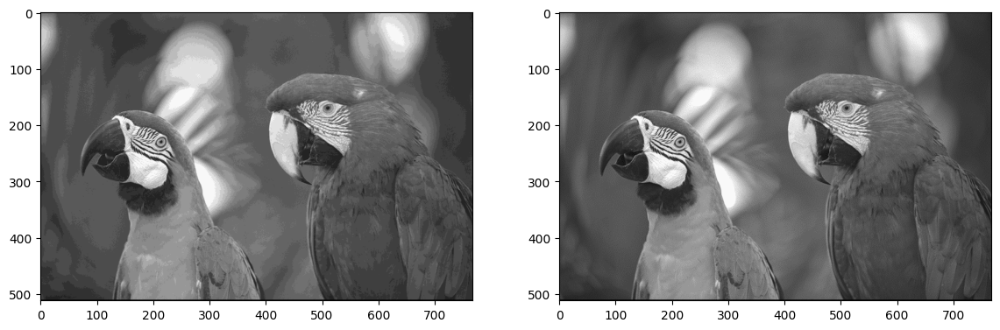

In [48]:
plt.subplot(121), plt.imshow(quantized_16_grey.astype(np.uint8))  
plt.subplot(122), plt.imshow(dithering_16_grey.astype(np.uint8)) 

In [71]:
plot_rgb_histograms(quantized_16_grey)
plot_rgb_histograms(dithering_16_grey)

In [21]:
kmeans_16 = KMeans(n_clusters=16).fit(np.reshape(img, (-1, 3)))
colors_kmeans_16 = kmeans_16.cluster_centers_

In [23]:
quantized_16 = quantize(img, colors_kmeans_16)
dithering_16 = dithering_img(img, colors_kmeans_16)

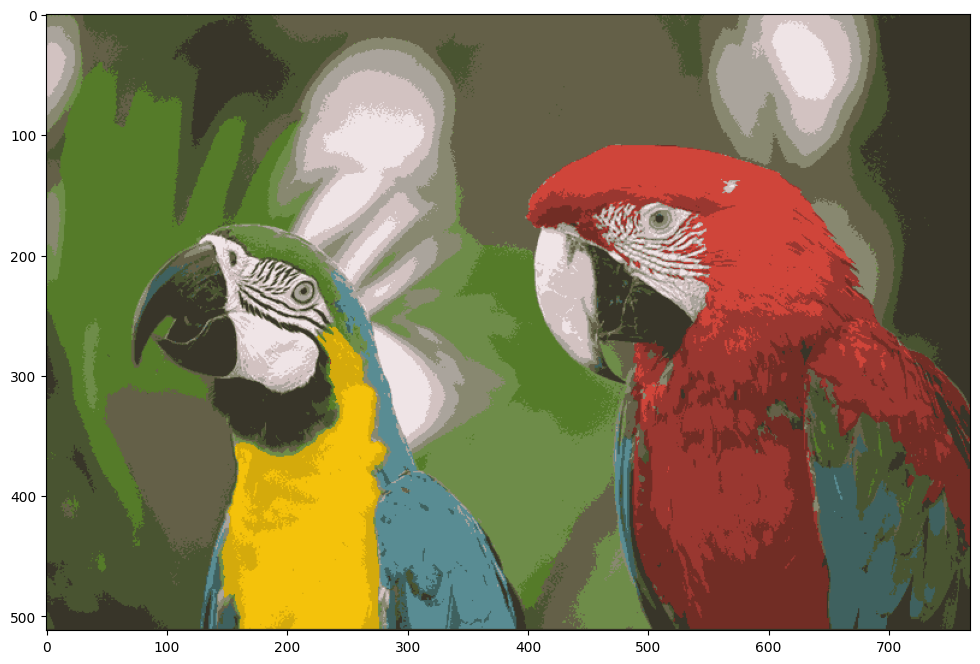

In [24]:
plt.imshow(quantized_16.astype(np.uint8))

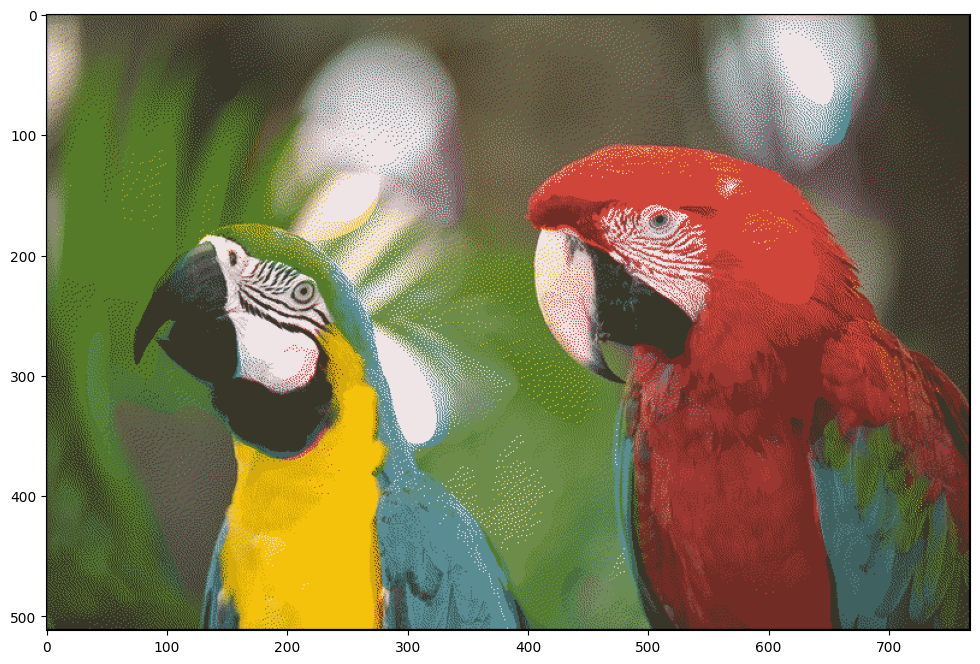

In [25]:
plt.imshow(dithering_16.astype(np.uint8))

In [26]:
kmeans32 = KMeans(n_clusters=32).fit(np.reshape(img, (-1, 3)))
colors_kmeans_32 = kmeans32.cluster_centers_

In [27]:
quantized_32 = quantize(img, colors_kmeans_32)
dithering_32 = dithering_img(img, colors_kmeans_32)

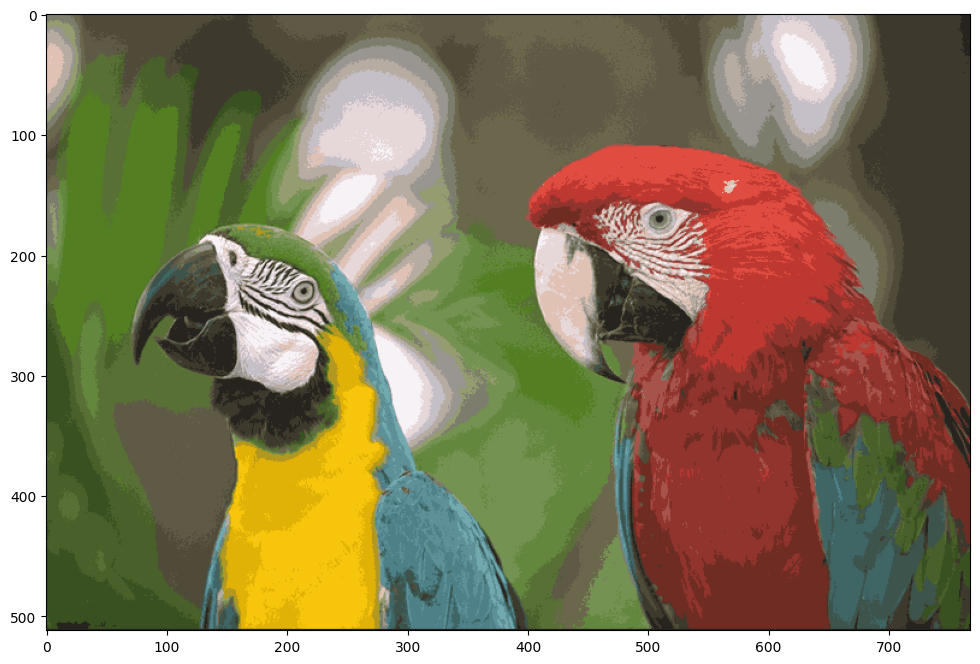

In [28]:
plt.imshow(quantized_32.astype(np.uint8))


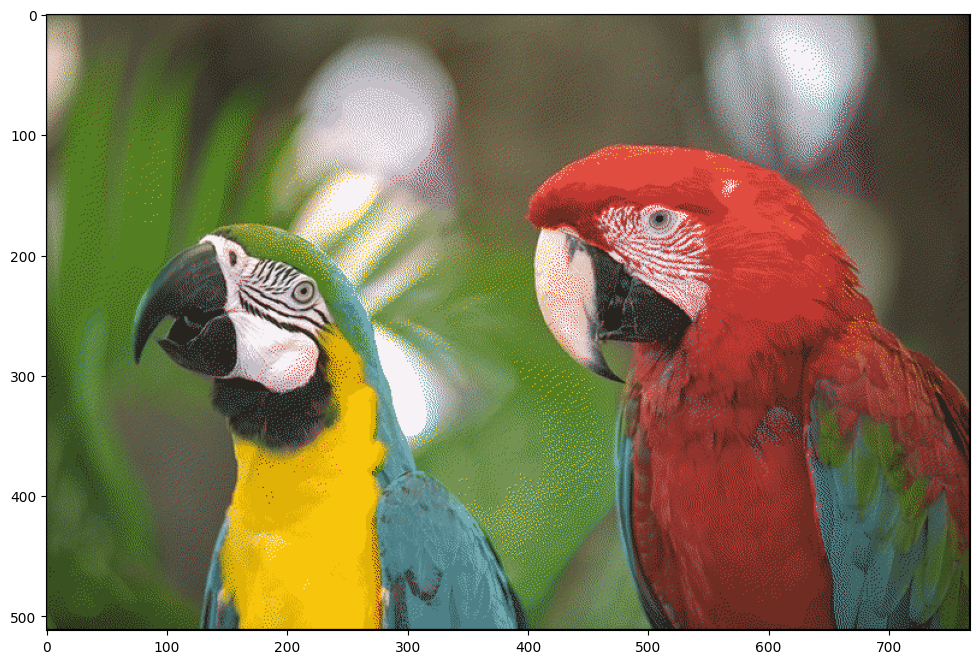

In [29]:
plt.imshow(dithering_32.astype(np.uint8))

Apply FS dithering the same way you did before.
* How does the result look like to you?
* What happens if we use 32 colours?
* And what happens if we use 256 colours?